In [1]:
import os
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import holoviews, pygraphviz
import networkx as nx
import pandas as pd
import matplotlib.patches as mpatches
from scipy import stats


ModuleNotFoundError: No module named 'holoviews'

In [13]:
import pylab as pyl

In [2]:
myroot = "~/bulk_analysis/"

print(os.getcwd())
natmiVizOut = "natmiD7/Network_exp_0_spe_0_det_0.2_top_0_signal_lrc2p_weight_mean/"
tb = pd.read_csv(f'{myroot}{natmiVizOut}Edges.csv',sep=",", header=0)
tb.head()

/home/bioinfo/bulk_analysis/graphmodeling


,Sending cluster,Ligand symbol,Receptor symbol,Target cluster,Ligand detection rate,Ligand average expression value,Ligand derived specificity of average expression value,Receptor detection rate,Receptor average expression value,Receptor derived specificity of average expression value,Edge average expression weight,Edge average expression derived specificity
0,sCs,Agt,Mas1,ECs,1,0.277334,1.0,1,0.284201,0.073664,0.078819,0.073664
1,sCs,Agt,Mas1,FAPs,1,0.277334,1.0,1,2.742778,0.710923,0.760666,0.710923
2,sCs,Agt,Mas1,sCs,1,0.277334,1.0,1,0.831075,0.215413,0.230486,0.215413
3,sCs,Agt,Agtr1a,FAPs,1,0.277334,1.0,1,17.156118,0.696806,4.757978,0.696806
4,sCs,Agt,Agtr1a,sCs,1,0.277334,1.0,1,7.464964,0.303194,2.070290,0.303194


In [164]:
(max(tb['Ligand average expression value']), max(tb['Receptor average expression value']))

(6033.696161818039, 2062.6146349088103)

(array([2288., 1375., 1195.,  796.,  590.,  417.,  409.,  365.,  327.,
        1034.]),
 array([1.04103212e-04, 1.00093693e-01, 2.00083283e-01, 3.00072872e-01,
        4.00062462e-01, 5.00052052e-01, 6.00041641e-01, 7.00031231e-01,
        8.00020821e-01, 9.00010410e-01, 1.00000000e+00]),
 <BarContainer object of 10 artists>)

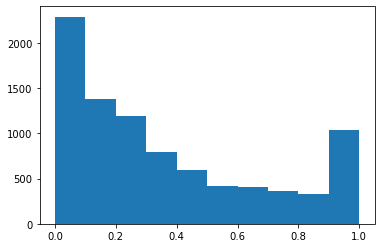

In [167]:
plt.hist(tb['Ligand derived specificity of average expression value'])

(array([1525., 1553., 1337., 1213., 1264., 1250.,  597.,   46.,    3.,
           8.]),
 array([0.01449167, 0.34450537, 0.67451906, 1.00453275, 1.33454644,
        1.66456014, 1.99457383, 2.32458752, 2.65460121, 2.98461491,
        3.3146286 ]),
 <BarContainer object of 10 artists>)

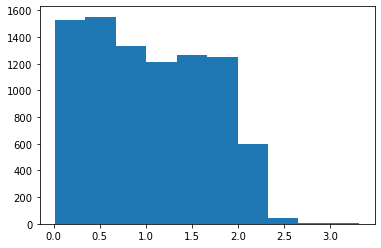

In [170]:
plt.hist(np.log10(np.array(tb['Receptor average expression value'])+1))

In [34]:
# make UNIQUE the ligand and receptor names by combining celltype alongside
tb['uniq_Ligand_symbol'] = tb['Ligand symbol'] + '_' + tb['Sending cluster']
tb['uniq_Receptor_symbol'] = tb['Receptor symbol'] + '_' + tb['Target cluster']

(array([592., 255., 204., 197., 165., 164., 143., 118., 125., 122.,  98.,
         99.,  78.,  72., 101.,  82.,  71.,  72.,  59.,  78.,  70.,  69.,
         62.,  56.,  48.,  53.,  53.,  57.,  69.,  49.]),
 array([1.89686429e-07, 9.99918635e-04, 1.99964758e-03, 2.99937653e-03,
        3.99910548e-03, 4.99883443e-03, 5.99856338e-03, 6.99829233e-03,
        7.99802128e-03, 8.99775023e-03, 9.99747918e-03, 1.09972081e-02,
        1.19969371e-02, 1.29966660e-02, 1.39963950e-02, 1.49961239e-02,
        1.59958529e-02, 1.69955818e-02, 1.79953108e-02, 1.89950397e-02,
        1.99947687e-02, 2.09944976e-02, 2.19942266e-02, 2.29939555e-02,
        2.39936845e-02, 2.49934134e-02, 2.59931424e-02, 2.69928713e-02,
        2.79926003e-02, 2.89923292e-02, 2.99920582e-02]),
 <BarContainer object of 30 artists>)

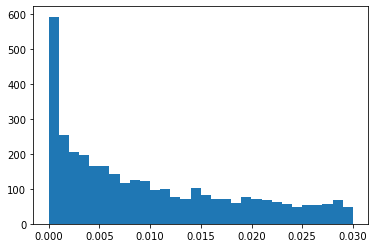

In [162]:
plt.hist([ i for i in tb['Edge average expression derived specificity'] if i < 0.03], bins=30)

(array([8.756e+03, 2.400e+01, 9.000e+00, 3.000e+00, 2.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([2.62937005e-03, 1.73560235e+05, 3.47120466e+05, 5.20680698e+05,
        6.94240930e+05, 8.67801162e+05, 1.04136139e+06, 1.21492163e+06,
        1.38848186e+06, 1.56204209e+06, 1.73560232e+06]),
 <BarContainer object of 10 artists>)

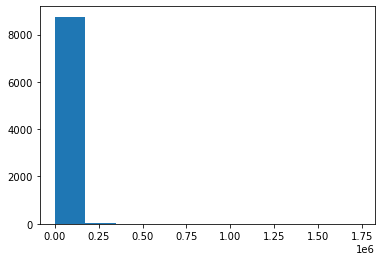

In [163]:
plt.hist( [i for i in tb['Edge average expression weight']])

In [35]:
celltycolors = {'FAPs':'#5F9EA0' , 'sCs': '#DFC27D' , 'M1': '#13306db2', 
                   'M2': '#E66101', 'Neutro': '#73D055FF', 'ECs': '#b8627db2'}

In [45]:
GY7 = nx.DiGraph()
for index,row in tb.iterrows():
    nodefrom = row['uniq_Ligand_symbol']
    nodeto = row['uniq_Receptor_symbol']
    celltypefrom = row['Sending cluster']
    celltypeto = row['Target cluster']
    GY7.add_node(nodefrom,
                nodetype = 'sender',
                celltype = celltypefrom,
                genesym = row['Ligand symbol'],
                color = celltycolors[celltypefrom],
                averagexp = row['Ligand average expression value'])
    GY7.add_node(nodeto,
                nodetype = 'receiver',
                celltype = celltypeto, 
                genesym = row['Receptor symbol'],
                color = celltycolors[celltypeto],
                averagexp = row['Receptor average expression value'])
    GY7.add_edge(nodefrom,nodeto, origtype = nodefrom,
                ecolor = celltycolors[celltypefrom],
                weight = row['Edge average expression weight'])

In [46]:
nodeexpressions = [ i for i in nx.get_node_attributes(GY7, 'averagexp').values()]

(array([  3.,   9.,  11.,  24.,  39.,  65.,  90.,  99., 123., 149., 150.,
        167., 146., 141., 144., 146., 107., 108.,  97.,  69.,  47.,  36.,
         13.,   5.,   9.,   2.,   2.,   3.,   3.,   2.]),
 array([-3.38341809, -2.98046699, -2.57751588, -2.17456477, -1.77161367,
        -1.36866256, -0.96571146, -0.56276035, -0.15980925,  0.24314186,
         0.64609296,  1.04904407,  1.45199517,  1.85494628,  2.25789738,
         2.66084849,  3.06379959,  3.4667507 ,  3.8697018 ,  4.27265291,
         4.67560401,  5.07855512,  5.48150622,  5.88445733,  6.28740843,
         6.69035954,  7.09331064,  7.49626175,  7.89921285,  8.30216396,
         8.70511506]),
 <BarContainer object of 30 artists>)

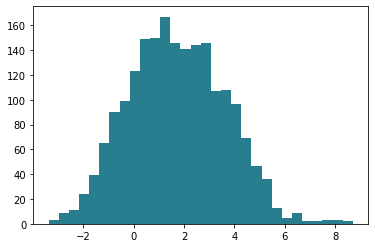

In [47]:
plt.hist(np.log(nodeexpressions), bins=30, color='#287D8EFF')

(array([151., 187., 180., 157., 150., 151., 123., 115., 114., 104., 105.,
         76.,  91.,  70.,  60.,  52.,  34.,  29.,  24.,   9.,   4.,   6.,
          5.,   2.,   0.,   2.,   3.,   1.,   2.,   2.]),
 array([0.03336831, 0.32243206, 0.61149581, 0.90055956, 1.18962331,
        1.47868706, 1.76775081, 2.05681455, 2.3458783 , 2.63494205,
        2.9240058 , 3.21306955, 3.5021333 , 3.79119705, 4.0802608 ,
        4.36932455, 4.6583883 , 4.94745205, 5.2365158 , 5.52557954,
        5.81464329, 6.10370704, 6.39277079, 6.68183454, 6.97089829,
        7.25996204, 7.54902579, 7.83808954, 8.12715329, 8.41621704,
        8.70528079]),
 <BarContainer object of 30 artists>)

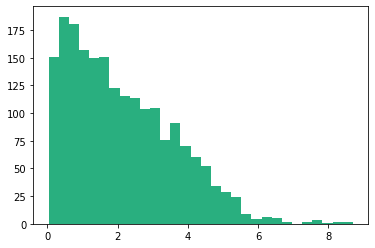

In [48]:
plt.hist(np.log(np.array(nodeexpressions)+1), bins=30, color='#29AF7FFF')

In [49]:
nodes = GY7.nodes()
edges = GY7.edges()
ccc = [ i for i in nx.get_node_attributes(GY7, 'color').values()]
eee = [ i for i in nx.get_edge_attributes(GY7, 'ecolor').values()]

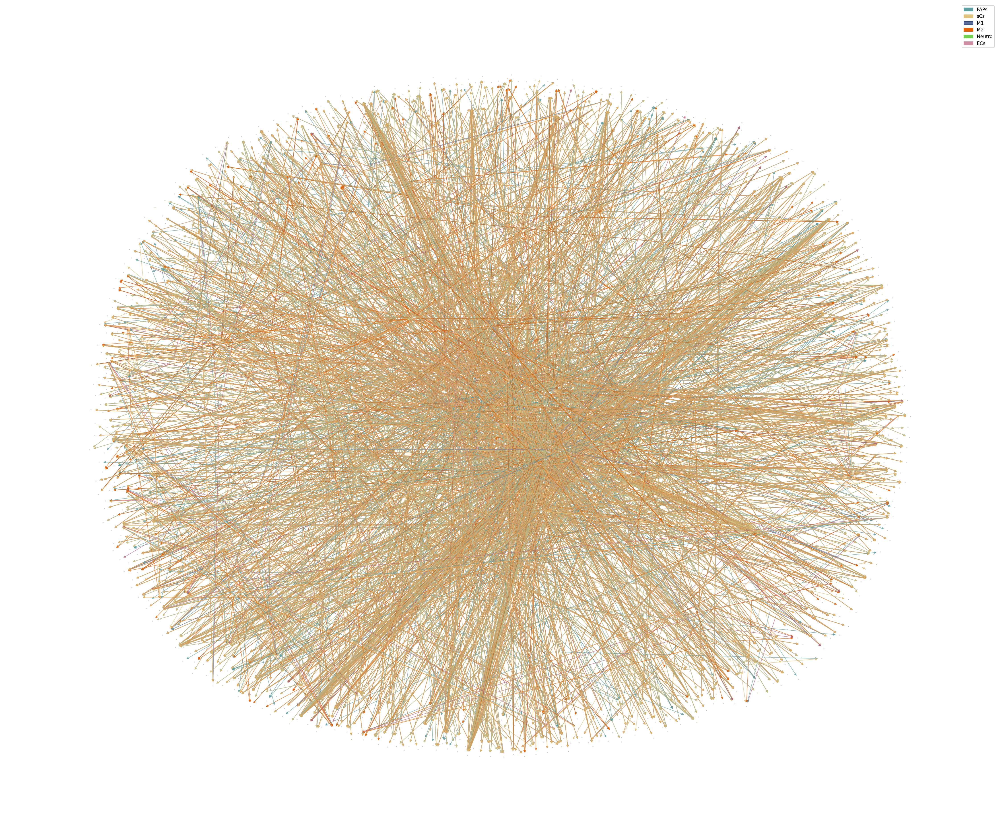

In [41]:
pos = nx.spring_layout(GY7)

fig = plt.figure (figsize=(30,25),dpi=150)
color_patches = []
for key, value in celltycolors.items():
    tmppatch = mpatches.Patch(color=value, label=key)
    color_patches.append(tmppatch)

nodes = nx.draw_networkx_nodes(GY7,
                              pos,
                               node_size = 2,
                              node_color = ccc, edgecolors = 'lightgray', 
                              alpha=0.7)
edges = nx.draw_networkx_edges(GY7,
                              pos,
                              edge_color = eee, alpha=0.7)
ax = plt.gca()
ax.set_axis_off()
fig.tight_layout()
plt.legend(handles=color_patches)

fig.savefig('YoungD7_all8000interactions.pdf', dpi=150)

In [134]:
uGY7 = nx.Graph(GY7)

In [150]:
 GY7.number_of_nodes(), uGY7.number_of_nodes()

(2009, 2009)

In [137]:
maxconncomp = sorted(nx.connected_components(uGY7), key=len, reverse=True)

In [138]:
u_sub = uGY7.subgraph(maxconncomp[0])

In [141]:
u_sub.number_of_nodes()

1524

In [107]:
for component in list(nx.connected_components(uGY7)):
    if len(component) < 1500:
        for node in component:
            uGY7.remove_node(node)

In [146]:
u_sub.number_of_nodes()

1524

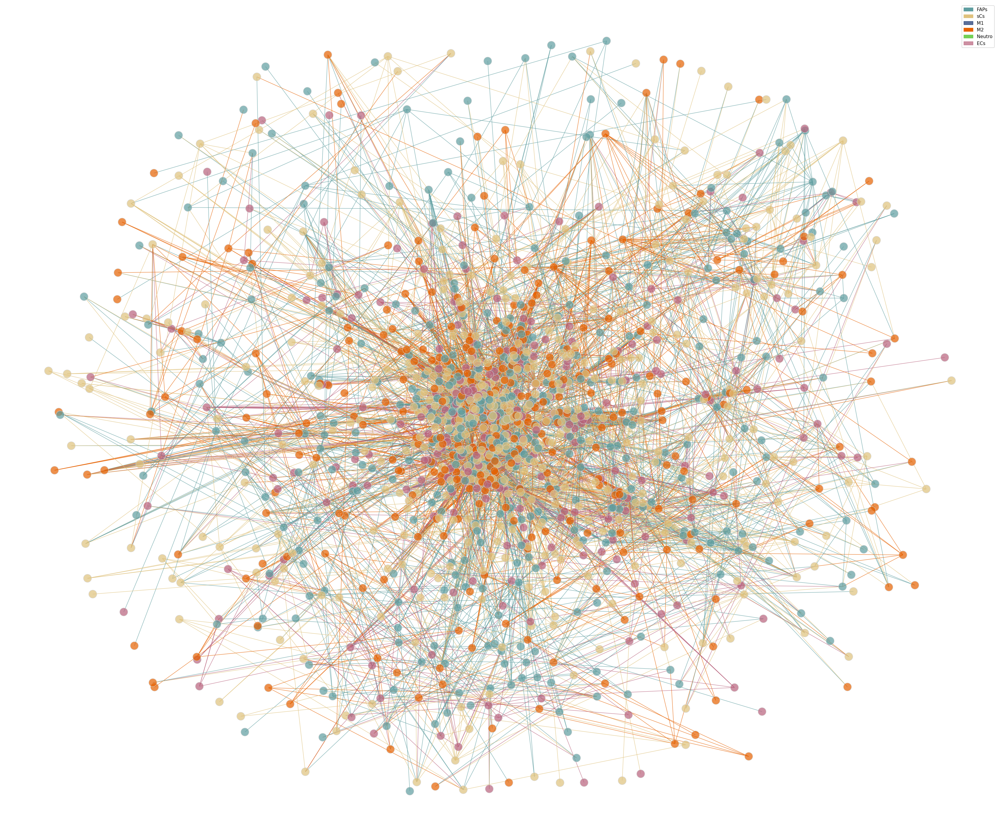

In [156]:
nodes = u_sub.nodes()
edges = u_sub.edges()
ccc = [ i for i in nx.get_node_attributes(u_sub, 'color').values()]
eee = [ i for i in nx.get_edge_attributes(u_sub, 'ecolor').values()]

pos = nx.spring_layout(u_sub, k=0.5)

fig = plt.figure (figsize=(30,25),dpi=150)
color_patches = []
for key, value in celltycolors.items():
    tmppatch = mpatches.Patch(color=value, label=key)
    color_patches.append(tmppatch)

nodes = nx.draw_networkx_nodes(u_sub,
                              pos,
                              node_color = ccc, edgecolors = 'lightgray', 
                              alpha=0.7)
edges = nx.draw_networkx_edges(u_sub,
                              pos,
                              edge_color = eee, alpha=0.7)
ax = plt.gca()
ax.set_axis_off()
fig.tight_layout()
plt.legend(handles=color_patches)

fig.savefig('YoungD7_connectedComp_undirected.pdf', dpi=150)

In [165]:
# coloring cliques in black
somecli = []
for k in list(nx.find_cliques(u_sub)):
    if k.number_of_edges() > 300 & k.number_of_edges() <





In [166]:
cliques

<generator object find_cliques at 0x7f5a68d28cf0>

In [ ]:
N = GGRAPH.number_of_edges()
edge_colors = range(2,N + 2)
edge_alphas = [(5 + i) / (N + 4) for i in range(M)]